In [1]:
# Installing Ultralytics for using Yolo model
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 568.9 kB/s eta 0:00:00 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 865.6/865.6 kB 5.3 MB/s eta 0:00:00a 0:00:01


In [30]:
#Importing Libraries
import numpy as np      # linear algebra
import pandas as pd     # data processing, CSV file I/O (e.g. pd.read_csv)
import os               # Operating syatem library for file handling
import yaml             # yaml related operations
from PIL import Image   # for reading images
from IPython.display import Video
import random           # generates random numbers
import cv2              # Computer vision tasks
import shutil

#Importing yolo pretrained model
import ultralytics 
ultralytics.checks()
from ultralytics import YOLO

#Disable warnings in code
import warnings
warnings.filterwarnings("ignore")

# Importing visualization libraries and configuration
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style="darkgrid", palette="deep", color_codes=True, rc=None)

os.environ["WANDB_DISABLED"] = 'true'

Ultralytics YOLOv8.2.75 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 5771.8/8062.4 GB disk)


In [3]:
#Creating object of YOLO and loading YOLO V8 Nano Segmentation model 
model = YOLO("yolov8n-seg.pt")

100%|██████████| 6.74M/6.74M [00:00<00:00, 77.2MB/s]


In [4]:
# Loading Dataset - Setting kaggle path to variable
path = "/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8"
# Setting yaml file path which contains datset configurations required for model
yaml_path = os.path.join(path, "data.yaml")
# Content of yaml file
with open(yaml_path, "r") as f:
    content_yaml = yaml.load(f, Loader=yaml.FullLoader) 
    print(yaml.dump(content_yaml))

names:
- Pothole
nc: 1
roboflow:
  license: CC BY 4.0
  project: pothole_segmentation_yolov8
  url: https://universe.roboflow.com/farzad/pothole_segmentation_yolov8/dataset/1
  version: 1
  workspace: farzad
train: ../train/images
val: ../valid/images



In [5]:
# Paths of training and validation images
train_path = os.path.join(path, "train/images")
valid_path = os.path.join(path, "valid/images")

# defining function for counting images in files and checking for sizes
def check_sizes_and_count_of_images(file_path):
    counter = 0
    sizes = set()
    for fname in os.listdir(file_path):
        if fname.endswith(".jpg"):
            counter += 1
            ipath = os.path.join(file_path, fname)
            with Image.open(ipath) as img:
                sizes.add(img.size)
    return counter, sizes

# using function for counting file and for checking sizes
train_count, train_sizes = check_sizes_and_count_of_images(train_path)
valid_count, valid_sizes = check_sizes_and_count_of_images(valid_path)

# Printing Counts
print(f"Count of Training Images in Dataset - {train_count}")
print(f"Count of Validation Images in Dataset - {valid_count}")

# Check if all images in training and validation set have the same size
if len(train_sizes) == 1:
    print(f"All training images have the same size - {train_sizes.pop()}")
else:
    print("Training images have varying sizes.")
    
if len(valid_sizes) == 1:
    print(f"All validation images have the same size - {valid_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Count of Training Images in Dataset - 720
Count of Validation Images in Dataset - 60
All training images have the same size - (640, 640)
All validation images have the same size - (640, 640)


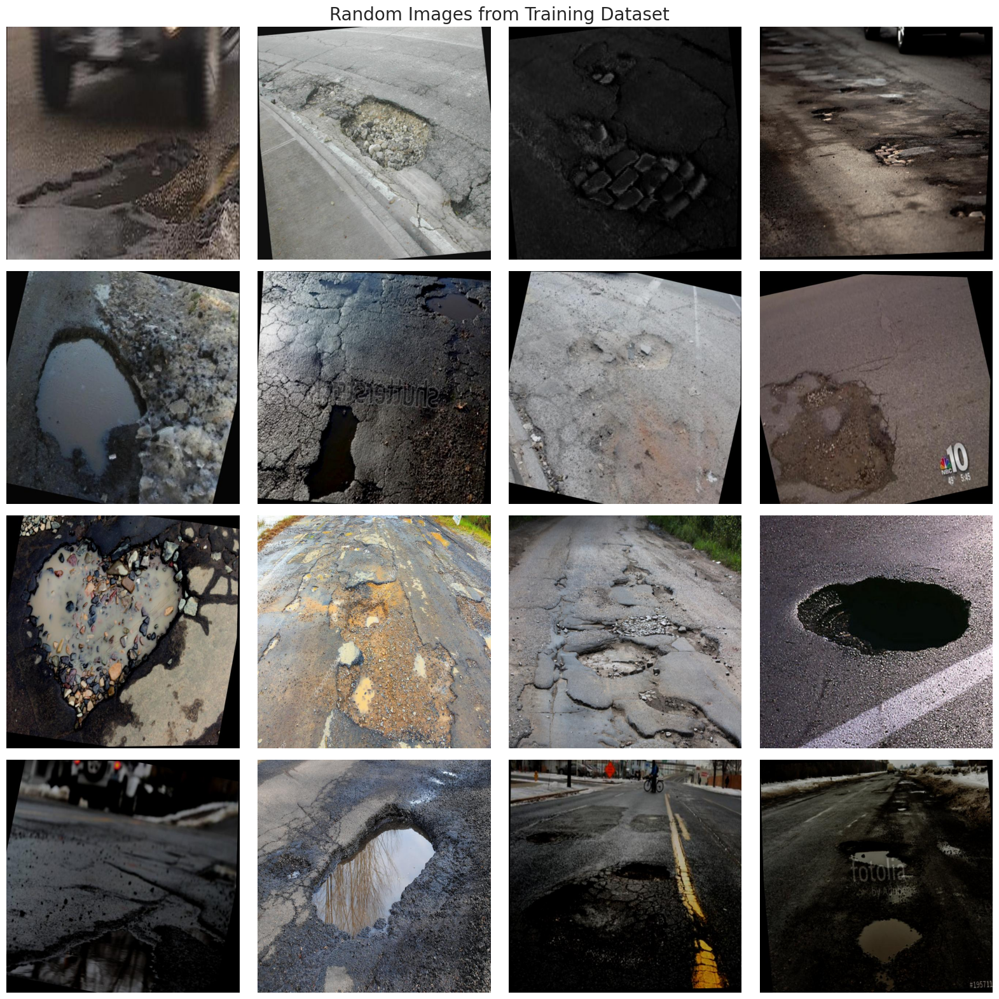

In [6]:
# Checking random images from dataset
# Initializing random number generation. it generates value based on seed
random.seed(42)

# Creating list of training image files
img_files = [i for i in os.listdir(train_path) if i.endswith(".jpg")]

# Selecting random 16 images from training dataset
random_imgs = random.sample(img_files, 16)

# Creating new figure displaying 16 images and giving title
plt.figure(figsize=(16,16))
plt.suptitle("Random Images from Training Dataset", fontsize=20)

# Looping each image to display in 4X4 grid format
for i, img in enumerate(random_imgs):
    img_path = os.path.join(train_path, img)
    image = Image.open(img_path)
    plt.subplot(4, 4, i+1)
    plt.imshow(image)
    plt.axis("off")
    
# Show the plot
plt.tight_layout()
plt.show()

# Deleting unnecessary variable to free up memory
del img_files

In [7]:
# Training model on custom pothole detection dataset
results = model.train(
    data = yaml_path,   # Path to the dataset configuration file
    epochs = 100,        # Number of epochs to train model
    imgsz = 640,        # Pixel Size of input images as integer 
    patience = 15,      # Epochs to wait for no observable improvement for early stopping of training 
    batch = 16,         # Number of Images in each batch
    optimizer = "auto", # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp]
    lr0 = 0.0001,       # Initial Learning rate of Model - Hyperparameter
    lrf = 0.01,         # Final Learning rate
    dropout = 0.25,     # Use dropout regularization
    device = 0,         # Device to run on, i.e. cuda device=0
    seed=42             # Random seed for reproducibility
)

Ultralytics YOLOv8.2.75 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolov8n-seg.pt, data=/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/data.yaml, epochs=100, time=None, patience=15, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=42, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.25, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False

100%|██████████| 755k/755k [00:00<00:00, 14.8MB/s]
2024-08-10 03:28:17,102	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-08-10 03:28:18,130	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...


100%|██████████| 6.25M/6.25M [00:00<00:00, 72.9MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/train/labels... 720 images, 0 backgrounds, 0 corrupt: 100%|██████████| 720/720 [00:01<00:00, 365.09it/s]

train: WARNING ⚠️ Cache directory /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/train is not writeable, cache not saved.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<00:00, 336.76it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid is not writeable, cache not saved.


Plotting labels to runs/segment/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 66 weight(decay=0.0), 77 weight(decay=0.0005), 76 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/segment/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.14G       1.49      2.939       2.32      1.449         49        640: 100%|██████████| 45/45 [00:16<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.88it/s]

                   all         60        201      0.832     0.0299      0.223      0.105      0.971     0.0348      0.253      0.112



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/100       2.9G      1.481      2.482      1.876      1.451         77        640: 100%|██████████| 45/45 [00:10<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.69it/s]

                   all         60        201      0.183      0.254      0.125     0.0489      0.188      0.249      0.131     0.0474



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.87G      1.492      2.457      1.798       1.47         58        640: 100%|██████████| 45/45 [00:10<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.99it/s]

                   all         60        201      0.182      0.184     0.0992     0.0378      0.165      0.194     0.0931     0.0311



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.81G      1.488      2.417       1.65      1.448         80        640: 100%|██████████| 45/45 [00:10<00:00,  4.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.00it/s]

                   all         60        201      0.412      0.423      0.359      0.184       0.41      0.398      0.337      0.161



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.86G      1.435      2.314      1.487      1.393         84        640: 100%|██████████| 45/45 [00:10<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.86it/s]

                   all         60        201      0.431      0.537       0.42      0.218      0.489      0.443      0.422      0.203



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.86G      1.435       2.35      1.477      1.424         76        640: 100%|██████████| 45/45 [00:10<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.14it/s]

                   all         60        201      0.585      0.557      0.566      0.287      0.564      0.537      0.539      0.266



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.83G      1.411      2.272      1.415      1.394         54        640: 100%|██████████| 45/45 [00:10<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.09it/s]

                   all         60        201      0.385      0.473      0.387      0.192      0.348       0.43      0.344      0.164



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.86G      1.382      2.266      1.346      1.366         62        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.11it/s]

                   all         60        201      0.619      0.627      0.587      0.318      0.624      0.632      0.605      0.297



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.99G      1.359       2.19      1.276      1.333         92        640: 100%|██████████| 45/45 [00:10<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.05it/s]

                   all         60        201      0.552      0.612      0.567      0.283      0.564      0.627      0.579      0.269



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.97G      1.339       2.16      1.272      1.331         45        640: 100%|██████████| 45/45 [00:10<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.05it/s]

                   all         60        201      0.593      0.609      0.599       0.31      0.622      0.638      0.604      0.299



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.83G      1.383      2.178      1.274      1.356         54        640: 100%|██████████| 45/45 [00:10<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.97it/s]

                   all         60        201      0.663      0.582      0.615      0.321      0.666      0.595      0.621      0.323



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.86G      1.324      2.155       1.22      1.309         83        640: 100%|██████████| 45/45 [00:10<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.19it/s]

                   all         60        201      0.666      0.562       0.61      0.339      0.649      0.571      0.607      0.326



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.84G      1.288      2.084      1.181      1.298         61        640: 100%|██████████| 45/45 [00:10<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]

                   all         60        201      0.608      0.587      0.605      0.326      0.629      0.607      0.623      0.329



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.93G      1.301      2.081      1.174      1.314         64        640: 100%|██████████| 45/45 [00:10<00:00,  4.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.14it/s]

                   all         60        201      0.569      0.617      0.548      0.304      0.584      0.632      0.574      0.297



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.81G      1.302      2.082      1.184      1.316         62        640: 100%|██████████| 45/45 [00:10<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.01it/s]

                   all         60        201      0.558      0.667      0.588      0.315      0.566      0.677       0.61      0.305



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/100       2.9G      1.309      2.068      1.191      1.301         64        640: 100%|██████████| 45/45 [00:10<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.28it/s]

                   all         60        201      0.668      0.537      0.602      0.323      0.676      0.542      0.595      0.306



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.84G      1.252      2.048      1.117      1.271         80        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.36it/s]

                   all         60        201      0.615      0.517      0.537      0.302      0.642      0.517      0.551      0.296



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.91G      1.251      2.017      1.081      1.277         67        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.24it/s]

                   all         60        201      0.665      0.543       0.56      0.307      0.667      0.537      0.558      0.305



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.92G      1.255      2.012      1.078      1.283         69        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.13it/s]

                   all         60        201      0.616      0.678      0.669      0.368      0.616      0.678      0.672      0.355



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.92G      1.213      1.936      1.024      1.241         73        640: 100%|██████████| 45/45 [00:10<00:00,  4.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.28it/s]

                   all         60        201      0.702      0.607      0.659      0.365      0.702      0.607      0.661      0.322



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.89G      1.212      1.961       1.05      1.245         67        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         60        201      0.693      0.607      0.679      0.384      0.706      0.617      0.686      0.375



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.84G      1.206      1.912      1.001      1.233        100        640: 100%|██████████| 45/45 [00:10<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.11it/s]

                   all         60        201      0.668      0.662      0.662      0.364      0.682      0.652       0.64      0.341



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.91G      1.179      1.877      0.987      1.225         47        640: 100%|██████████| 45/45 [00:10<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.25it/s]

                   all         60        201      0.695      0.587      0.641      0.385      0.752      0.572      0.657      0.358



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/100       2.9G      1.181      1.844      0.953      1.212         83        640: 100%|██████████| 45/45 [00:10<00:00,  4.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.10it/s]

                   all         60        201       0.63      0.627       0.66      0.378      0.646      0.632      0.663      0.351



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.96G       1.15      1.852     0.9486      1.214         60        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.14it/s]

                   all         60        201      0.661      0.657      0.661      0.398      0.698      0.632      0.665      0.368



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.97G      1.145      1.802     0.9264      1.196         72        640: 100%|██████████| 45/45 [00:10<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.18it/s]

                   all         60        201      0.641      0.647      0.626      0.363      0.653      0.637      0.636       0.35



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.92G      1.146      1.836      0.931        1.2         80        640: 100%|██████████| 45/45 [00:10<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.17it/s]

                   all         60        201      0.648      0.595      0.628      0.353       0.61      0.612       0.61      0.328



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.81G      1.152      1.848     0.9125      1.198         83        640: 100%|██████████| 45/45 [00:10<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.31it/s]

                   all         60        201      0.652      0.587      0.607      0.352      0.658      0.592      0.608      0.329



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.98G      1.157      1.844     0.9313      1.191         64        640: 100%|██████████| 45/45 [00:10<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         60        201      0.613      0.678       0.62      0.368      0.622      0.688      0.644      0.356



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.94G      1.102      1.769     0.8655      1.173         66        640: 100%|██████████| 45/45 [00:10<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.00it/s]

                   all         60        201      0.664      0.667      0.653      0.366      0.664      0.667      0.649      0.353



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.93G      1.111      1.755     0.8793      1.171         93        640: 100%|██████████| 45/45 [00:10<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.18it/s]

                   all         60        201      0.634      0.701      0.682      0.386      0.643      0.711      0.684       0.38



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/100      3.04G       1.14       1.79     0.8977      1.202         82        640: 100%|██████████| 45/45 [00:10<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         60        201      0.674      0.642      0.671       0.38       0.68      0.644      0.674      0.369



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.88G      1.116      1.785     0.8706      1.177         78        640: 100%|██████████| 45/45 [00:10<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.24it/s]

                   all         60        201      0.625      0.647      0.656      0.405      0.646      0.647      0.663      0.376



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.83G      1.073      1.716     0.8487       1.16         73        640: 100%|██████████| 45/45 [00:10<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.22it/s]

                   all         60        201      0.685      0.617      0.674      0.406      0.707      0.638      0.693       0.39



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.87G      1.076       1.72     0.8421      1.149         94        640: 100%|██████████| 45/45 [00:10<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.34it/s]

                   all         60        201      0.652      0.657      0.673      0.403       0.66      0.667      0.677      0.363



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.92G      1.055      1.726     0.8379      1.149         73        640: 100%|██████████| 45/45 [00:10<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.01it/s]

                   all         60        201      0.676      0.627      0.642      0.388      0.701      0.642      0.688      0.385



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.87G      1.047      1.704      0.813      1.149         86        640: 100%|██████████| 45/45 [00:10<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.09it/s]

                   all         60        201      0.583      0.682      0.626      0.354      0.614      0.667      0.648      0.356



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.83G      1.075      1.747     0.8296      1.157         44        640: 100%|██████████| 45/45 [00:10<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.13it/s]

                   all         60        201      0.668       0.66      0.664      0.401      0.655      0.643      0.679      0.384



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.91G      1.027      1.683     0.7773       1.12         65        640: 100%|██████████| 45/45 [00:10<00:00,  4.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.03it/s]

                   all         60        201      0.689      0.637      0.657       0.39      0.709      0.632      0.673      0.373



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.86G      1.047      1.682     0.7758      1.144         92        640: 100%|██████████| 45/45 [00:10<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.35it/s]

                   all         60        201      0.664      0.672      0.672      0.382      0.722      0.647      0.677      0.376



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.95G      1.061      1.677     0.8019      1.129         67        640: 100%|██████████| 45/45 [00:10<00:00,  4.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.19it/s]

                   all         60        201      0.626      0.682      0.663      0.395      0.651      0.679      0.687      0.383



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.97G      1.034      1.641     0.7713      1.145         58        640: 100%|██████████| 45/45 [00:10<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.85it/s]

                   all         60        201      0.672      0.592      0.662      0.393      0.708      0.622      0.687       0.38



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.87G      1.016      1.609     0.7495      1.118         89        640: 100%|██████████| 45/45 [00:10<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.14it/s]

                   all         60        201      0.672      0.562      0.628      0.373      0.696      0.582      0.648      0.348



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.83G      1.019      1.639     0.7614      1.126         73        640: 100%|██████████| 45/45 [00:10<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.31it/s]

                   all         60        201      0.686      0.617       0.66      0.393      0.689      0.627      0.681      0.381



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/100       2.9G     0.9946      1.614     0.7389      1.117         62        640: 100%|██████████| 45/45 [00:10<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.10it/s]

                   all         60        201      0.727      0.667      0.701      0.431      0.761      0.667      0.734      0.413



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.89G     0.9905      1.627       0.73      1.112         64        640: 100%|██████████| 45/45 [00:10<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.05it/s]

                   all         60        201       0.69      0.632      0.692      0.416      0.713      0.657       0.72      0.392



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.81G     0.9858      1.638      0.734      1.119         53        640: 100%|██████████| 45/45 [00:10<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.24it/s]

                   all         60        201      0.659      0.622       0.67       0.39      0.718      0.607      0.676      0.381



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.87G     0.9907      1.611     0.7271      1.094        106        640: 100%|██████████| 45/45 [00:10<00:00,  4.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.28it/s]

                   all         60        201      0.691      0.646      0.674      0.415      0.699      0.648       0.69      0.388



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.93G     0.9967      1.591     0.7169      1.105         69        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.20it/s]

                   all         60        201      0.748      0.612      0.673      0.377      0.722      0.657      0.691      0.359



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.84G     0.9935        1.6     0.7174      1.112         80        640: 100%|██████████| 45/45 [00:10<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.17it/s]

                   all         60        201      0.679      0.672      0.665        0.4      0.684      0.677      0.666      0.374



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.92G      1.007      1.624     0.7258      1.101         88        640: 100%|██████████| 45/45 [00:10<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.27it/s]

                   all         60        201      0.642      0.637      0.634      0.382      0.635      0.632      0.631       0.36



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.89G     0.9787       1.58     0.7053      1.106         58        640: 100%|██████████| 45/45 [00:10<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.17it/s]

                   all         60        201      0.685      0.652      0.685      0.421      0.715      0.642      0.696      0.398



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.96G     0.9485      1.537     0.6805      1.089         69        640: 100%|██████████| 45/45 [00:10<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.13it/s]

                   all         60        201       0.74      0.572      0.665      0.416      0.757      0.587      0.695      0.405



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.81G     0.9278      1.513     0.6562      1.066         82        640: 100%|██████████| 45/45 [00:10<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.09it/s]

                   all         60        201      0.709      0.632        0.7      0.416      0.729      0.647      0.711       0.41



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.84G     0.9586      1.567     0.6782      1.097         83        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.26it/s]

                   all         60        201      0.704      0.614       0.69      0.405      0.709      0.627      0.697      0.405



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.81G     0.9616      1.545     0.6862      1.091         80        640: 100%|██████████| 45/45 [00:10<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.14it/s]

                   all         60        201      0.612      0.677       0.66       0.41      0.617      0.682      0.684      0.394



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.96G     0.9421      1.488     0.6534      1.075         90        640: 100%|██████████| 45/45 [00:10<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.26it/s]

                   all         60        201       0.63      0.647      0.658      0.408      0.692      0.647      0.697      0.376



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/100      2.85G     0.9396      1.517     0.6643      1.065         67        640: 100%|██████████| 45/45 [00:10<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.19it/s]

                   all         60        201      0.677      0.698      0.696      0.411      0.747      0.652      0.704      0.399



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/100       2.9G     0.9352      1.513     0.6635      1.068         80        640: 100%|██████████| 45/45 [00:10<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.13it/s]

                   all         60        201       0.72      0.639      0.693      0.407      0.718      0.652       0.69      0.386



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.97G     0.9167      1.496     0.6461      1.054         80        640: 100%|██████████| 45/45 [00:10<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.88it/s]

                   all         60        201      0.726      0.582      0.659        0.4      0.743      0.597      0.681      0.394
EarlyStopping: Training stopped early as no improvement observed in last 15 epochs. Best results observed at epoch 45, best model saved as best.pt.
To update EarlyStopping(patience=15) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



60 epochs completed in 0.208 hours.
Optimizer stripped from runs/segment/train/weights/last.pt, 6.8MB
Optimizer stripped from runs/segment/train/weights/best.pt, 6.8MB

Validating runs/segment/train/weights/best.pt...
Ultralytics YOLOv8.2.75 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n-seg summary (fused): 195 layers, 3,258,259 parameters, 0 gradients, 12.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.62it/s]


                   all         60        201      0.736      0.662      0.702       0.43      0.761      0.665      0.735      0.414
Speed: 0.2ms preprocess, 3.4ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/segment/train


lr/pg0,▁▅████▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂
lr/pg1,▁▅████▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂
lr/pg2,▁▅████▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▂▂▂
metrics/mAP50(B),▂▁▄▅▄▇▇▇▇▆▇▆█▇█▇█▇▇▇████▇███▇▇███████▇██
metrics/mAP50(M),▂▁▃▄▃▆▆▇▇▆▆▆▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇█▇▇▇███▇██
metrics/mAP50-95(B),▂▁▃▄▄▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇█▇▇▇██████
metrics/mAP50-95(M),▂▁▃▄▃▆▆▆▆▆▆▆▇▆▇▇▇▇▆▇▇▇█▇▇▇▇▇▇▇█▇▇▇██████
metrics/precision(B),█▁▃▄▃▆▅▆▆▅▆▆▆▇▆▇▆▆▆▆▆▆▆▆▅▆▆▆▆▆▆▆▇▆▆▇▇▆▆▇
metrics/precision(M),█▁▃▄▂▅▅▅▅▅▅▅▅▆▅▆▆▅▅▅▅▅▆▅▅▅▆▅▆▅▆▆▆▅▆▆▆▅▆▆
metrics/recall(B),▁▃▅▆▆▇▇▇▇▇▆▆█▇█▇█▇▇██▇▇█████▇▇▇▇▇█▇▇▇███
metrics/recall(M),▁▃▅▅▅▇▇▇▇▇▆▆█▇▇▇▇▇▇██▇▇██▇▇█▇▇▇▇▇█▇▇▇█▇█


In [8]:
# model performance evaluation
post_training_paths = '/kaggle/working/runs/segment/train'
# listing files in path 
!ls {post_training_paths}

BoxF1_curve.png					  labels.jpg
BoxPR_curve.png					  labels_correlogram.jpg
BoxP_curve.png					  results.csv
BoxR_curve.png					  results.png
MaskF1_curve.png				  train_batch0.jpg
MaskPR_curve.png				  train_batch1.jpg
MaskP_curve.png					  train_batch2.jpg
MaskR_curve.png					  val_batch0_labels.jpg
args.yaml					  val_batch0_pred.jpg
confusion_matrix.png				  val_batch1_labels.jpg
confusion_matrix_normalized.png			  val_batch1_pred.jpg
events.out.tfevents.1723260513.f0ded173ea75.34.0  weights


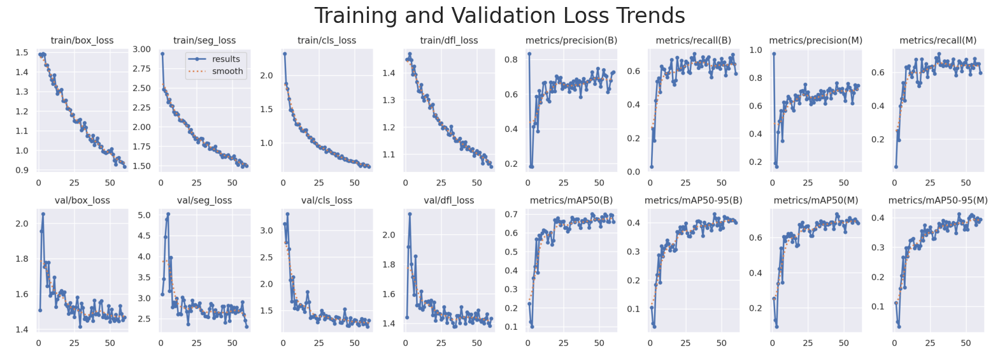

In [9]:
# Creating full file path of trained model
res_file_path = os.path.join(post_training_paths, 'results.png')
# Reading images using CV2
image = cv2.imread(res_file_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
# Display the image using matplotlib
plt.figure(figsize=(20,8))
plt.imshow(image)
plt.title('Training and Validation Loss Trends', fontsize=24)
plt.axis('off') 
plt.show()

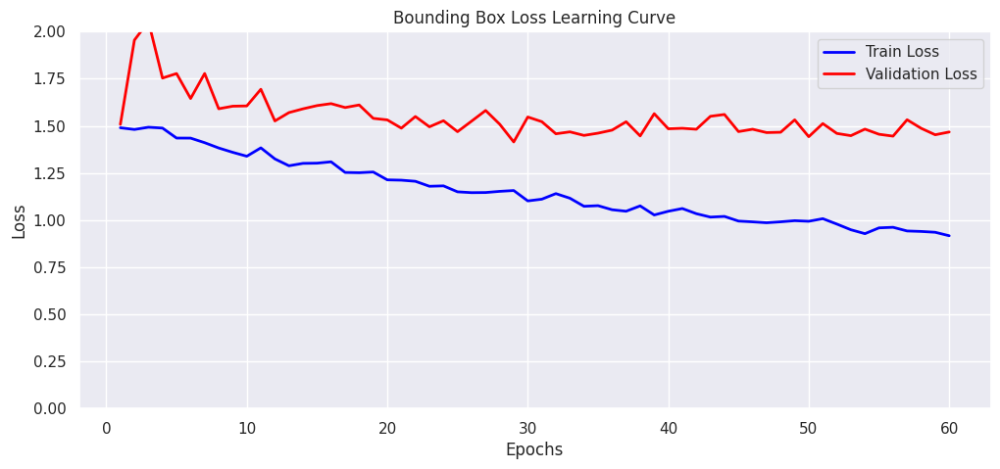

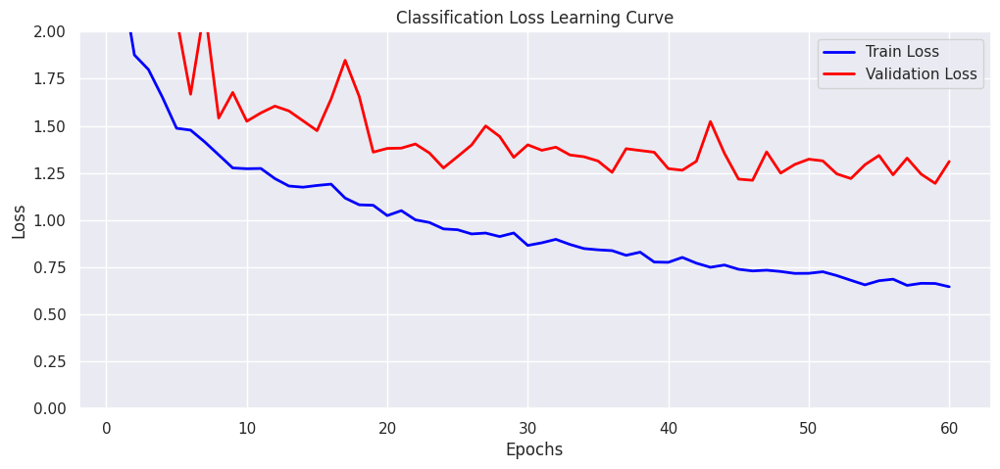

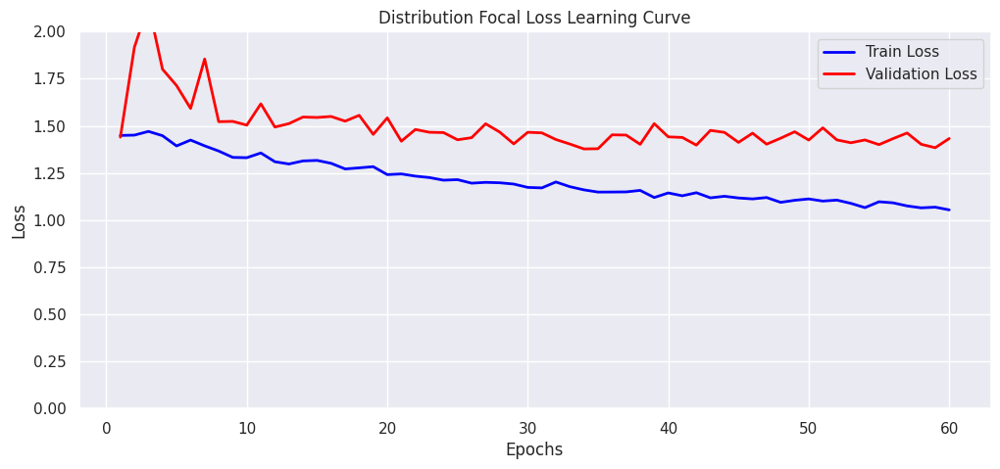

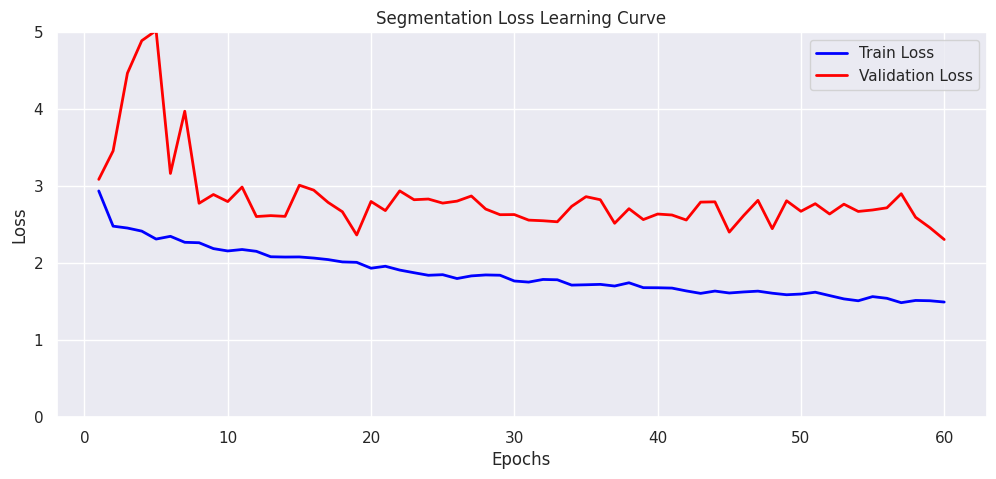

In [13]:
# Function for plotting learning curves based on models performance
def plot_learning_curves(df, train_loss_col, val_loss_col, title, ylim_range = [0,2]):
    plt.figure(figsize = (12,5))
    sns.lineplot(data = df, x = 'epoch', y = train_loss_col, label = "Train Loss", color = "blue", linewidth = 2)
    sns.lineplot(data = df, x = 'epoch', y = val_loss_col, label = "Validation Loss", color = "red", linewidth = 2)
    plt.title(title)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.ylim(ylim_range)
    plt.legend()
    plt.show()
    
# Creating full file path for results.csv
res_csv_path = os.path.join(post_training_paths, "results.csv")

# Loading CSV file into dataframe and removing spaces from column names
df = pd.read_csv(res_csv_path)
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curves(df, 'train/box_loss', 'val/box_loss', 'Bounding Box Loss Learning Curve')
plot_learning_curves(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curves(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')
plot_learning_curves(df, 'train/seg_loss', 'val/seg_loss', 'Segmentation Loss Learning Curve', ylim_range=[0,5])

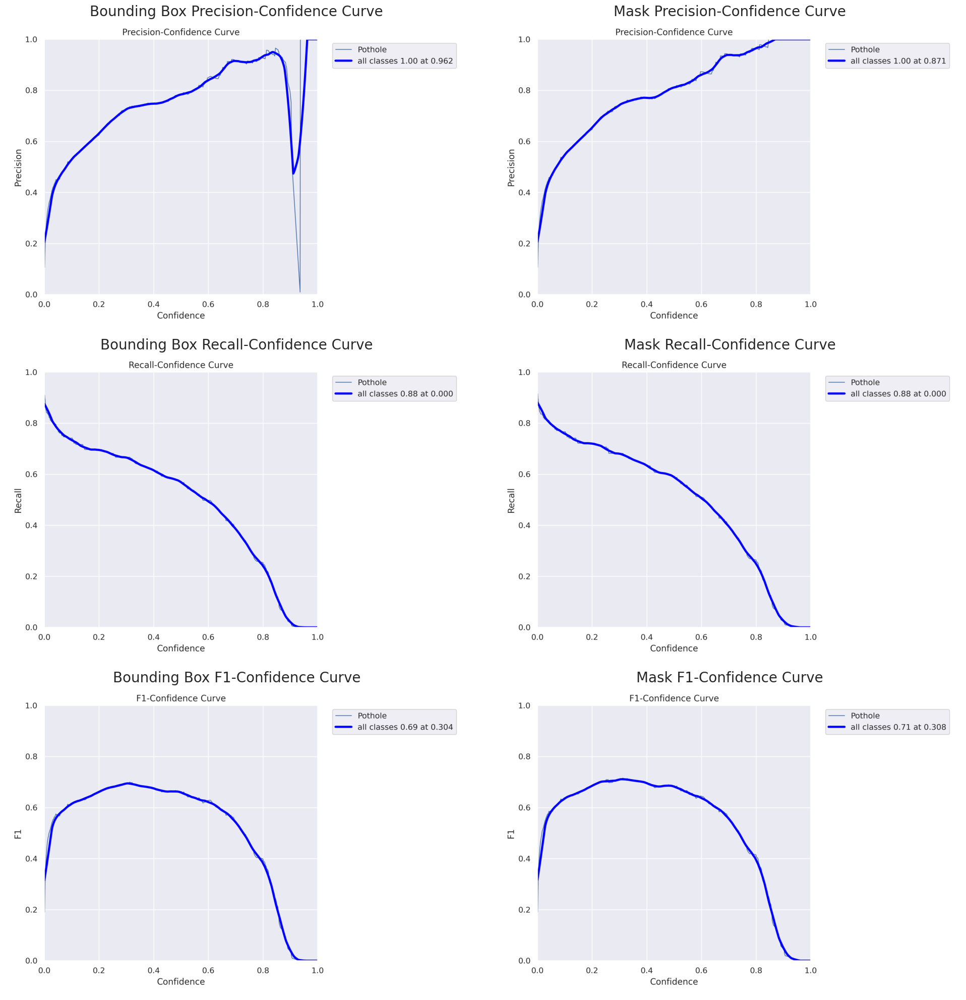

In [15]:
# Define the filenames for 'Box' and 'Mask' metrics along with their titles
box_files_titles = {
    'BoxP_curve.png': 'Bounding Box Precision-Confidence Curve',
    'BoxR_curve.png': 'Bounding Box Recall-Confidence Curve',
    'BoxF1_curve.png': 'Bounding Box F1-Confidence Curve'
}

mask_files_titles = {
    'MaskP_curve.png': 'Mask Precision-Confidence Curve',
    'MaskR_curve.png': 'Mask Recall-Confidence Curve',
    'MaskF1_curve.png': 'Mask F1-Confidence Curve'
}

# Create a 3x2 subplot
fig, axs = plt.subplots(3, 2, figsize=(20, 20))

# Function to read and convert image for plotting
def read_and_convert_image(file_path):
    # Read the image using cv2
    image = cv2.imread(file_path)
    # Convert from BGR to RGB
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Plot 'Box' images in the first column with meaningful titles
for i, (filename, title) in enumerate(box_files_titles.items()):
    img_path = os.path.join(post_training_paths, filename)
    img = read_and_convert_image(img_path)
    axs[i, 0].imshow(img)
    axs[i, 0].set_title(title, fontsize=20)
    axs[i, 0].axis('off') 

# Plot 'Mask' images in the second column with meaningful titles
for i, (filename, title) in enumerate(mask_files_titles.items()):
    img_path = os.path.join(post_training_paths, filename)
    img = read_and_convert_image(img_path)
    axs[i, 1].imshow(img)
    axs[i, 1].set_title(title, fontsize=20)
    axs[i, 1].axis('off')  

plt.tight_layout()
plt.show()

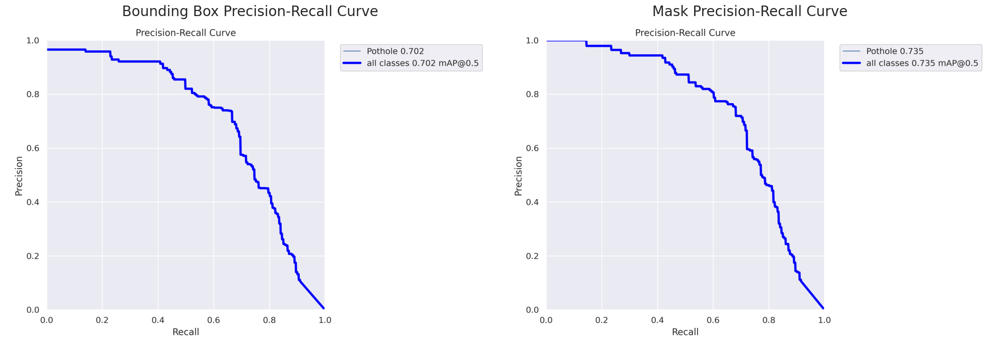

In [16]:
# Define the filenames for 'Box' and 'Mask' metrics along with their titles
pr_files_titles = {
    'BoxPR_curve.png': 'Bounding Box Precision-Recall Curve',
    'MaskPR_curve.png': 'Mask Precision-Recall Curve'
}

# Create a 1x2 subplot
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

# Plot 'Box' and 'Mask' images in the subplot with meaningful titles
for i, (filename, title) in enumerate(pr_files_titles.items()):
    img_path = os.path.join(post_training_paths, filename)
    img = read_and_convert_image(img_path)
    axs[i].imshow(img)
    axs[i].set_title(title, fontsize=20)
    axs[i].axis('off')

plt.tight_layout()
plt.show()

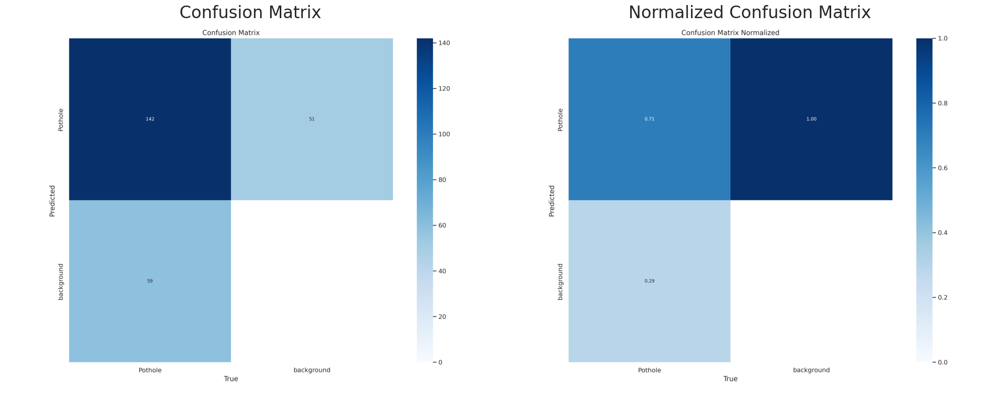

In [18]:
# Construct the path to the confusion matrix images
confusion_matrix_path = os.path.join(post_training_paths, 'confusion_matrix.png')
confusion_matrix_normalized_path = os.path.join(post_training_paths, 'confusion_matrix_normalized.png')

# Create a 1x2 subplot
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

# Read and convert both images
cm_img = read_and_convert_image(confusion_matrix_path)
cm_norm_img = read_and_convert_image(confusion_matrix_normalized_path)

# Display the images
axs[0].imshow(cm_img)
axs[0].set_title('Confusion Matrix', fontsize=24)
axs[0].axis('off') 

axs[1].imshow(cm_norm_img)
axs[1].set_title('Normalized Confusion Matrix', fontsize=24)
axs[1].axis('off')

plt.tight_layout()
plt.show()

In [20]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join(post_training_paths, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics YOLOv8.2.75 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8n-seg summary (fused): 195 layers, 3,258,259 parameters, 0 gradients, 12.0 GFLOPs


val: Scanning /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<00:00, 781.39it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.12s/it]


                   all         60        201      0.727      0.667      0.701      0.429      0.761      0.667      0.734       0.41
Speed: 0.4ms preprocess, 22.2ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to runs/segment/val


In [21]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

,Metric Value
metrics/precision(B),0.727
metrics/recall(B),0.667
metrics/mAP50(B),0.701
metrics/mAP50-95(B),0.429
metrics/precision(M),0.761
metrics/recall(M),0.667
metrics/mAP50(M),0.734
metrics/mAP50-95(M),0.410
fitness,0.899



image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-17-_jpg.rf.0d172b6accedf4c52a3868d9b690d48b.jpg: 640x640 2 Potholes, 16.6ms
Speed: 1.8ms preprocess, 16.6ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-262-_jpg.rf.02970860794f859699c9f743bc0fd7d1.jpg: 640x640 2 Potholes, 16.2ms
Speed: 1.6ms preprocess, 16.2ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-60-_jpg.rf.4e715308cc8dc7455b767414cda028ab.jpg: 640x640 4 Potholes, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/valid/images/pic-178-_jpg.rf.2e27d006aec1544f1eec88d9170fd6ce.jpg: 640x640 1 

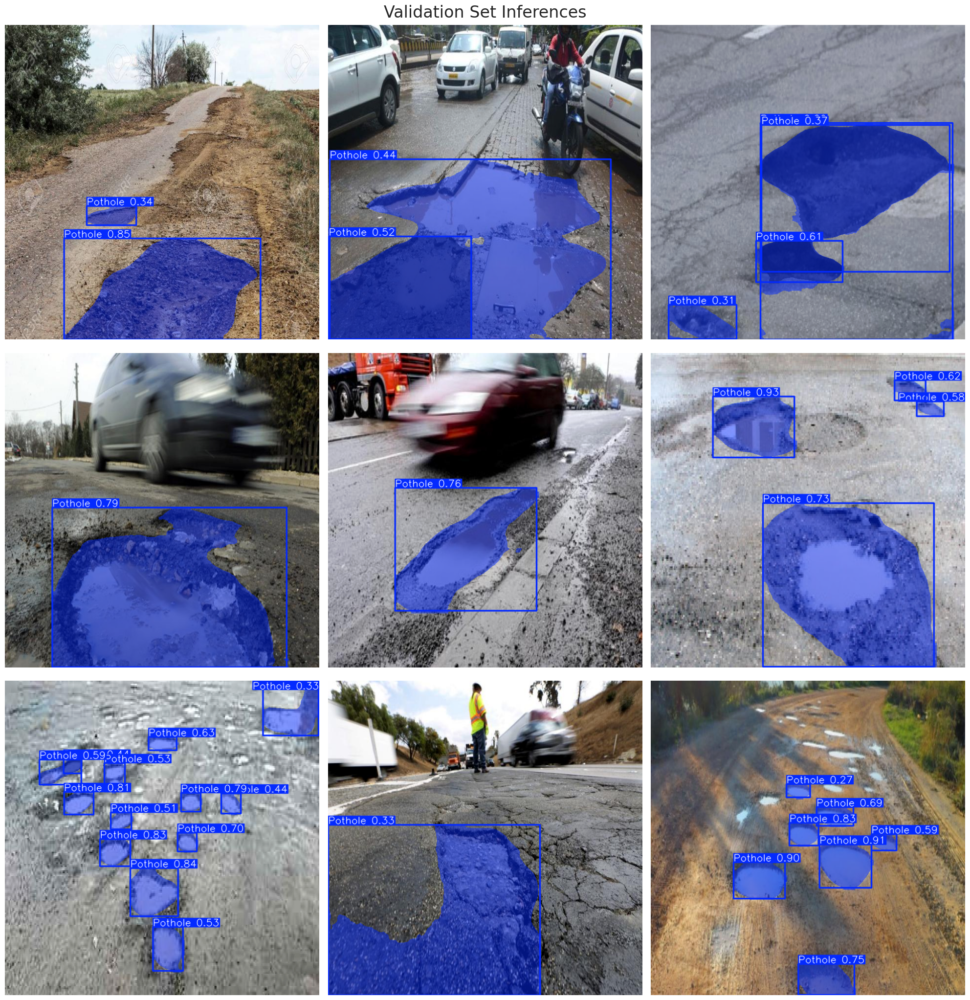

In [23]:
# Define the path to the validation images
valid_images_path = os.path.join(path, 'valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640)
    annotated_image = results[0].plot()
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()

In [27]:
# Define the path to the sample video in the dataset
dataset_video_path = '/kaggle/input/pothole-image-segmentation-dataset/Pothole_Segmentation_YOLOv8/sample_video.mp4'

# Define the destination path in the working directory
video_path = '/kaggle/working/sample_video.mp4'

# Copy the video file from its original location in the dataset to the current working directory in Kaggle
shutil.copyfile(dataset_video_path, video_path)

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/375) /kaggle/working/sample_video.mp4: 384x640 1 Pothole, 113.1ms
video 1/1 (frame 2/375) /kaggle/working/sample_video.mp4: 384x640 3 Potholes, 12.3ms
video 1/1 (frame 3/375) /kaggle/working/sample_video.mp4: 384x640 3 Potholes, 12.0ms
video 1/1 (frame 4/375) /kaggle/working/sample_video.mp4: 384x640 3 Potholes, 12.0ms
video 1/1 (frame 5/375) /kaggle/working/sample_video.mp4: 384x640 3 Potholes, 12.1ms
video 1/1 (frame 6/375) /kaggle

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: ultralytics.engine.results.Masks object
 names: {0: 'Pothole'}
 obb: None
 orig_img: array([[[146, 137, 129],
         [177, 168, 160],
         [178, 169, 161],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        [[197, 188, 180],
         [206, 197, 189],
         [164, 155, 147],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        [[150, 141, 133],
         [183, 174, 166],
         [188, 179, 171],
         ...,
         [246, 243, 244],
         [246, 243, 244],
         [246, 243, 244]],
 
        ...,
 
        [[ 80,  92, 102],
         [ 70,  82,  92],
         [ 63,  75,  85],
         ...,
         [ 61,  81, 101],
         [ 62,  82, 102],
         [ 65,  85, 105]],
 
        [[ 70,  82,  92],
         [ 63,  75,  85],
         [ 59,  71,  8

In [31]:
# Convert the .avi video generated by the YOLOv8 prediction to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i /kaggle/working/runs/segment/predict/sample_video.avi processed_sample_video.mp4

# Embed and display the processed sample video within the notebook
Video("processed_sample_video.mp4", embed=True, width=960)

In [ ]:
# Export the model
best_model.export(format='onnx')